In [12]:
# Perform all necessary imports

import pandas as pd, os, gc as gc, nltk, re, string, numpy as np, time, pickle, warnings
import matplotlib.pyplot as plt, plotly.express as px
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.model_selection import train_test_split, cross_validate, ShuffleSplit, cross_val_score
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB
from sklearn.svm import SVC # Per industry "best practice"
from nltk.corpus import stopwords
from nltk.stem.snowball import SnowballStemmer

gc.enable()

In [13]:
# Function to plot the distributions of each word in the df
def plot_df_distributions(df, name):
    # Loop through the df
    for col in df.columns:
        # Create a temp numpy array
        temp = df[col].to_numpy()
        # Plot the distribution
        n, bins, patches = plt.hist(temp, bins=10)
        # Set the title
        plt.suptitle("Data Type: {} | {} Distribution".format(str(name), str(col)))
        # Show the figure
        plt.show()
        
# Function to plot the distributions of each word in the df
def plot_pos_distributions(df, cols):
    # Loop through the df
    for col in cols:
        # Create a temp numpy array
        temp = df[col].to_numpy()
        # Plot the distribution
        n, bins, patches = plt.hist(temp, bins=10)
        # Set the title
        plt.suptitle("POS Tag: {} | Distribution".format(str(col)))
        # Show the figure
        plt.show()        

# Function to plot the results of the classifiers
def plot_results(df, name, metric):
    # Create a plotly figure, and plot whichever metric (best, worst, average) is passed
    fig = px.line(df, x='Simulation', y=metric, color='Classifier')
    # Update title/labels
    fig.update_layout(title='{} Data Classifier Performance'.format(name), xaxis_title='Simulation',
                             yaxis_title='Accuracy')
    # Display the figure
    fig.show()     
    
# This function removes numbers from an array
def remove_nums(arr): 
    # Declare a regular expression
    pattern = '[0-9]'  
    # Remove the pattern, which is a number
    arr = [re.sub(pattern, '', i) for i in arr]    
    # Return the array with numbers removed
    return arr

# This function cleans the passed in paragraph and parses it
def get_words(para, stem):   
    # Create a set of stop words
    stop_words = set(stopwords.words('english'))
    # Split it into lower case    
    lower = para.lower().split()
    # Remove punctuation
    no_punctuation = (nopunc.translate(str.maketrans('', '', string.punctuation)) for nopunc in lower)
    # Remove integers
    no_integers = remove_nums(no_punctuation)
    # Remove stop words
    dirty_tokens = (data for data in no_integers if data not in stop_words)
    # Ensure it is not empty
    tokens = [data for data in dirty_tokens if data.strip()]
    # Ensure there is more than 1 character to make up the word
    tokens = [data for data in tokens if len(data) > 1]
       
    if stem == True:
        # Perform stemming
        stemmer = SnowballStemmer('english')
        stemmed_tokens = [stemmer.stem(word) for word in tokens]
        return stemmed_tokens
    
    else:
        # Return the tokens
        return tokens 

# This function parses NLTK returned POS tuples
def parse_tuples(list_of_tuples, verbose):
    
    # Declare POS counts
    cnt_noun = 0
    cnt_adj = 0
    cnt_vb = 0
    cnt_other = 0
    
    # Loop through the returned tuples
    for tpl in list_of_tuples:
        
        # NOTE - If needed, verbose printing is available to
        # check for completeness.
        
        # If the word is a noun, increase the noun count
        if('NN' in tpl[1]):
            cnt_noun += 1
            if(verbose):
                print("Noun: {}".format(tpl))
        # If the word is an adjective, increase the adjective count
        elif('JJ' in tpl[1]):
            cnt_adj += 1
            if(verbose):
                print("Adjective: {}".format(tpl))
        # If the word is a verb, increase the verb count
        elif('VB' in tpl[1] or 'VP' in tpl[1]):
            cnt_vb += 1
            if(verbose):
                print("Verb: {}".format(tpl))
        # If the word isn't one of those 3, increase the other count
        else:
            cnt_other += 1
            if(verbose):
                print("Other: {}".format(tpl))
    
    # Return the counts
    return cnt_noun, cnt_adj, cnt_vb, cnt_other    

## Section 1: Using K-CFV and Simulated Results
This section will move to using 5-Fold CFV and to simulate results over multiple trials vs 1 static. Both the fold count and trial count are variables set below

In [14]:
folds = 5
sims = 10

In [15]:
# Import the data built by Iteration 1
boolean = pd.read_csv('Trimmed_Boolean.csv')
tfidf = pd.read_csv('Trimmed_TFIDF.csv')
freq = pd.read_csv('Trimmed_Count.csv')

# Create lists of the dataframes, and their names
dfs = [boolean, tfidf, freq]
names = ['Boolean', 'TFIDF', 'Frequency']

# Drop weird column pandas creates when writing to csv
for df in dfs:
    df.drop('Unnamed: 0', axis=1, inplace=True)

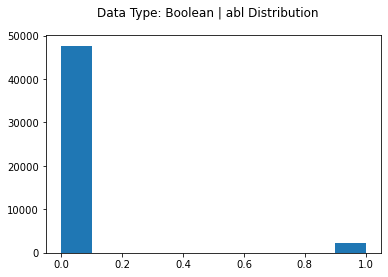

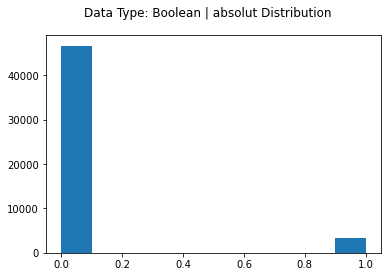

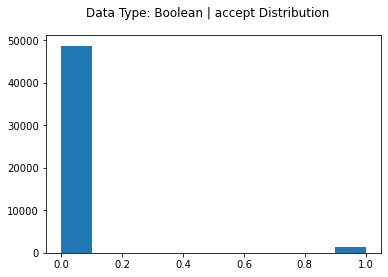

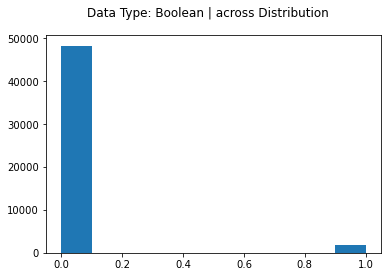

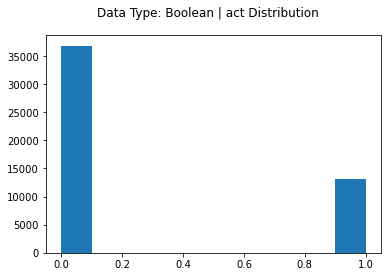

...

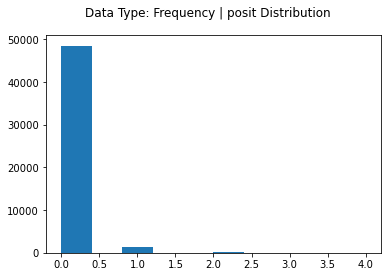

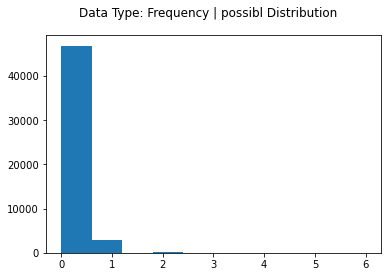

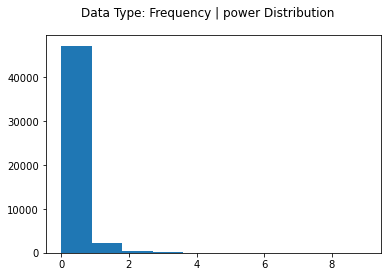

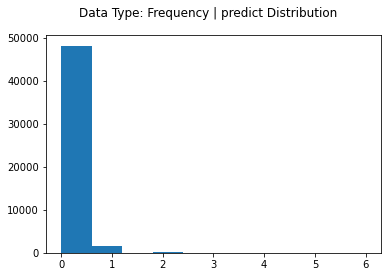

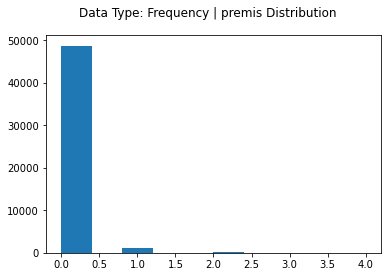

In [16]:
# Get some quick plots to show the distributions of each word in each dataset
for i in range(len(dfs)):
    plot_df_distributions(dfs[i], names[i])   

In [17]:
# Test some basic classifiers

# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
boolean_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
tfidf_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
freq_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    # Loop through each of the datasets
    for i in range(len(dfs)):
        print("*--------------------------------------------*")
        # Copy the dataset
        temp = dfs[i].copy()
        # Randomly shuffle it
        temp = temp.sample(frac=1).reset_index(drop=True)
        # Get your classes, maintaining the same index as the data
        classes = temp['classification']
        temp.drop('classification', inplace=True, axis=1)

        # Try each classifier
        for clf in classifiers:
            # Take the classifiers name
            name = str(clf.__class__.__name__)
            try:  
                # Utilize a shuffle split for the cross validation
                cv = ShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
                # Capture the best, worst, and average across the splits
                best = round(max(cross_val_score(clf, temp, classes, cv=cv)), 5)
                worst = round(min(cross_val_score(clf, temp, classes, cv=cv)), 5)
                avg = round((sum(cross_val_score(clf, temp, classes, cv=cv)) / len(cross_val_score(clf, temp, classes, cv=cv))), 5)
                # Print out results
                print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, names[i], name, best, worst, avg))
            except:
                # Alert if any error
                print("Error Calculating: {}".format(name))

            # Create a row to append to the respective df with the results
            temp_row = [n+1, name, best, worst, avg]
            
            # Append to correct df
            if(names[i] == 'Boolean'):
                boolean_results.loc[len(boolean_results), :] = temp_row
            elif(names[i] == 'TFIDF'):
                tfidf_results.loc[len(tfidf_results), :] = temp_row
            else:
                freq_results.loc[len(freq_results), :] = temp_row
        
        # Delete temp df
        del(temp)
        
        # Free up memory
        gc.collect()

*--------------------------------------------*
Simulation: 1 | Data: Boolean | Classifier: GaussianNB | Best: 0.81812 | Worst: 0.81345 | Average: 0.81545
Simulation: 1 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83261 | Worst: 0.82376 | Average: 0.8293
Simulation: 1 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82697 | Worst: 0.81739 | Average: 0.82139
*--------------------------------------------*
Simulation: 1 | Data: TFIDF | Classifier: GaussianNB | Best: 0.81436 | Worst: 0.80727 | Average: 0.80998
Simulation: 1 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83424 | Worst: 0.83036 | Average: 0.83248
Simulation: 1 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82745 | Worst: 0.81988 | Average: 0.82411
*--------------------------------------------*
Simulation: 1 | Data: Frequency | Classifier: GaussianNB | Best: 0.80188 | Worst: 0.794 | Average: 0.79822
Simulation: 1 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82606 | Worst: 0.82097 | Average: 0.823

Simulation: 8 | Data: TFIDF | Classifier: GaussianNB | Best: 0.8123 | Worst: 0.80588 | Average: 0.80828
Simulation: 8 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83079 | Worst: 0.82661 | Average: 0.82827
Simulation: 8 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82612 | Worst: 0.82097 | Average: 0.82331
*--------------------------------------------*
Simulation: 8 | Data: Frequency | Classifier: GaussianNB | Best: 0.80273 | Worst: 0.79721 | Average: 0.7993
Simulation: 8 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82812 | Worst: 0.81727 | Average: 0.82385
Simulation: 8 | Data: Frequency | Classifier: BernoulliNB | Best: 0.83085 | Worst: 0.82418 | Average: 0.82635
*--------------------------------------------*
Simulation: 9 | Data: Boolean | Classifier: GaussianNB | Best: 0.81673 | Worst: 0.80873 | Average: 0.81318
Simulation: 9 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83406 | Worst: 0.8257 | Average: 0.82989
Simulation: 9 | Data: Boolean | Classifier

In [18]:
# Store all results in one list
results = [boolean_results, tfidf_results, freq_results]   

# Plot the average across the folds for each dataset
for i in range(len(results)):
    plot_results(results[i], names[i], 'Average')

## Section 2: Rerunning above with scaled positive sentiment data
This portion of the notebook analyzes the effects of multiplying all positive sentiments by 3, while leaving negative sentiments at face value

In [19]:
# Perform the 3x scaling suggested by Professor Johnson

# First, create copies of the dfs
scaled_boolean = boolean.copy()
scaled_tfidf = tfidf.copy()
scaled_freq = freq.copy()

# Create list of scaled dfs
scaled_dfs = [scaled_boolean, scaled_tfidf, scaled_freq]

# Free memory
gc.collect()

2318

In [20]:
# Per Professor Johnson's instructions
for df in scaled_dfs:
    df['classification'].replace(1, 3, inplace=True)
    df['classification'].replace(-1, 1, inplace=True)

In [21]:
# Keep count of a particular word, to ensure it changes
old_written = scaled_freq['written']

# Loop through the scaled dfs
for df in scaled_dfs:
    # Multiply the values by *-1 if the sentiment was negative
    df.update(df.drop('classification',axis=1).mul(df.classification,axis=0)[df.classification.eq(3)])
    # Free up some memory
    gc.collect()
    
# Collect new written values
new_written = scaled_freq['written']

# Print out proof the word counts change
print("Old Written Values: {} | New Written Values: {}".format(sum(old_written), sum(new_written)))

Old Written Values: 2824 | New Written Values: 5520.0


In [22]:
# Get some quick plots to show the distributions of each word in each dataset
for i in range(len(scaled_dfs)):
    plot_df_distributions(scaled_dfs[i], names[i])   

In [23]:
# Test some basic classifiers

# Declare a list of classifiers to try
# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
scaled_boolean_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
scaled_tfidf_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])
scaled_freq_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    # Loop through each of the datasets
    for i in range(len(scaled_dfs)):
        print("*--------------------------------------------*")
        # Copy the dataset
        temp = scaled_dfs[i].copy()
        # Randomly shuffle it
        temp = temp.sample(frac=1).reset_index(drop=True)
        # Get your classes, maintaining the same index as the data
        classes = temp['classification']
        temp.drop('classification', inplace=True, axis=1)

        # Try each classifier
        for clf in classifiers:
            # Take the classifiers name
            name = str(clf.__class__.__name__)
            try:  
                # Utilize a shuffle split for the cross validation
                cv = ShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
                # Capture the best, worst, and average across the splits
                best = round(max(cross_val_score(clf, temp, classes, cv=cv)), 5)
                worst = round(min(cross_val_score(clf, temp, classes, cv=cv)), 5)
                avg = round((sum(cross_val_score(clf, temp, classes, cv=cv)) / len(cross_val_score(clf, temp, classes, cv=cv))), 5)
                # Print out results
                print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, names[i], name, best, worst, avg))
            except:
                # Alert if any error
                print("Error Calculating: {}".format(name))

            # Create a row to append to the respective df with the results
            temp_row = [n+1, name, best, worst, avg]
            
            # Append to correct df
            if(names[i] == 'Boolean'):
                scaled_boolean_results.loc[len(scaled_boolean_results), :] = temp_row
            elif(names[i] == 'TFIDF'):
                scaled_tfidf_results.loc[len(scaled_tfidf_results), :] = temp_row
            else:
                scaled_freq_results.loc[len(scaled_freq_results), :] = temp_row
        
        # Delete temp df
        del(temp)
        
        # Free up memory
        gc.collect()

*--------------------------------------------*
Simulation: 1 | Data: Boolean | Classifier: GaussianNB | Best: 0.96885 | Worst: 0.96709 | Average: 0.96789
Simulation: 1 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83394 | Worst: 0.82503 | Average: 0.82835
Simulation: 1 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82661 | Worst: 0.81697 | Average: 0.82239
*--------------------------------------------*
Simulation: 1 | Data: TFIDF | Classifier: GaussianNB | Best: 1.0 | Worst: 1.0 | Average: 1.0
Simulation: 1 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83509 | Worst: 0.82952 | Average: 0.83216
Simulation: 1 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82861 | Worst: 0.8203 | Average: 0.82428
*--------------------------------------------*
Simulation: 1 | Data: Frequency | Classifier: GaussianNB | Best: 0.92964 | Worst: 0.92442 | Average: 0.92765
Simulation: 1 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82521 | Worst: 0.82042 | Average: 0.82368
Simulat

Simulation: 8 | Data: TFIDF | Classifier: MultinomialNB | Best: 0.83564 | Worst: 0.83115 | Average: 0.83307
Simulation: 8 | Data: TFIDF | Classifier: BernoulliNB | Best: 0.82939 | Worst: 0.81988 | Average: 0.82408
*--------------------------------------------*
Simulation: 8 | Data: Frequency | Classifier: GaussianNB | Best: 0.93073 | Worst: 0.92624 | Average: 0.92839
Simulation: 8 | Data: Frequency | Classifier: MultinomialNB | Best: 0.82897 | Worst: 0.82091 | Average: 0.82433
Simulation: 8 | Data: Frequency | Classifier: BernoulliNB | Best: 0.82921 | Worst: 0.82139 | Average: 0.82495
*--------------------------------------------*
Simulation: 9 | Data: Boolean | Classifier: GaussianNB | Best: 0.96794 | Worst: 0.96594 | Average: 0.96707
Simulation: 9 | Data: Boolean | Classifier: MultinomialNB | Best: 0.83158 | Worst: 0.82909 | Average: 0.83045
Simulation: 9 | Data: Boolean | Classifier: BernoulliNB | Best: 0.82424 | Worst: 0.81927 | Average: 0.82162
*-----------------------------------

In [24]:
# Store all scaled results in one list
scaled_results = [scaled_boolean_results, scaled_tfidf_results, scaled_freq_results]   

# Display their average performance across the folds
for i in range(len(scaled_results)):
    plot_results(scaled_results[i], names[i], 'Average')

### Section 3: POS Tagging
This section will attempt to build a dataframe that, for each review, will count the number of nouns, verbs, adjectives, and other

In [26]:
# In order to properly POS Tag, the raw text, and not vectorized text is needed
raw_text = pd.read_csv('complete_movie_data.csv')
try:
    raw_text.drop('Unnamed: 0', axis=1, inplace=True)
except:
    pass
# Print out the first 10 rows
print(raw_text.head(n=10))

# Free up some memory
gc.collect()

                ID                                               Text  Class
0          0_2.txt  Once again Mr. Costner has dragged out a movie...     -1
1          0_3.txt  Story of a man who has unnatural feelings for ...     -1
2  10000_4 (2).txt  This is an example of why the majority of acti...     -1
3      10000_4.txt  Airport '77 starts as a brand new luxury 747 p...     -1
4      10001_1.txt  First of all I hate those moronic rappers, who...     -1
5      10001_4.txt  This film lacked something I couldn't put my f...     -1
6      10002_1.txt  Sorry everyone,,, I know this is supposed to b...     -1
7      10002_3.txt  Not even the Beatles could write songs everyon...     -1
8      10003_1.txt  When I was little my parents took me along to ...     -1
9      10003_3.txt  Brass pictures (movies is not a fitting word f...     -1


2404

In [27]:
# Declare a blank datafame
new_df = pd.DataFrame(columns = ['ReviewID', 'Nouns', 'Verbs', 'Adjectives', 'Other', 'Class'])

# Loop through the input data
for index, row in raw_text.iterrows():
    # Get the tokens according to discussed rules
    tokens = get_words(row['Text'], True)
    # Create the POS for each word
    res = nltk.pos_tag(tokens)
    # Parse the tuples, and get the counts
    nouns, adjectives, verbs, other = parse_tuples(res, False)
    # Create a temp row
    temp_row = [row['ID'], nouns, verbs, adjectives, other, row['Class']]
    # Append it to the dataframe
    new_df.loc[len(new_df), :] = temp_row

In [28]:
# Plot the distribution of word types across all documents
plot_pos_distributions(new_df, ['Nouns', 'Verbs', 'Adjectives', 'Other'])

In [29]:
# Test some basic classifiers

# Declare a list of classifiers to try
# Declare a list of classifiers to try
# classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB(), 
#                SVC(C=1.0, kernel='linear', degree=3, gamma='auto')]

classifiers = [GaussianNB(), MultinomialNB(), BernoulliNB()]

# Create blank dataframes to hold the results of the classification attempts
pos_results = pd.DataFrame(columns = ['Simulation', 'Classifier', 'Best', 'Worst', 'Average'])

# Run a given number of simulations
for n in range(sims):
    print("*--------------------------------------------*")
    # Create a temp for each simulation
    temp = new_df.copy()
    # Randomly shuffle it
    temp = temp.sample(frac=1).reset_index(drop=True)
    # Get your classes, maintaining the same index as the data
    classes = temp['Class']
    classes = classes.astype('int')
    # Drop irrelevant columns
    temp.drop(['Class', 'ReviewID'], inplace=True, axis=1)

    # Try each classifier
    for clf in classifiers:
        # Take the classifiers name
        name = str(clf.__class__.__name__)
        try:  
            # Utilize a shuffle split for the cross validation
            cv = ShuffleSplit(n_splits = folds, test_size = 0.33, random_state=np.random.randint(1,100))
            # Capture the best, worst, and average across the splits
            best = round(max(cross_val_score(clf, temp, classes, cv=cv)), 5)
            worst = round(min(cross_val_score(clf, temp, classes, cv=cv)), 5)
            avg = round((sum(cross_val_score(clf, temp, classes, cv=cv)) / len(cross_val_score(clf, temp, classes, cv=cv))), 5)
            # Print out results
            print("Simulation: {} | Data: {} | Classifier: {} | Best: {} | Worst: {} | Average: {}".format(n+1, names[i], name, best, worst, avg))
        except:
            # Alert if any error
            print("Error Calculating: {}".format(name))

        # Create a row to append to the respective df with the results
        temp_row = [n+1, name, best, worst, avg]
        pos_results.loc[len(pos_results), :] = temp_row
        
        # Free up memory
        gc.collect()

*--------------------------------------------*
Simulation: 1 | Data: Frequency | Classifier: GaussianNB | Best: 0.5501 | Worst: 0.54616 | Average: 0.54827
Simulation: 1 | Data: Frequency | Classifier: MultinomialNB | Best: 0.56465 | Worst: 0.55559 | Average: 0.55899
Simulation: 1 | Data: Frequency | Classifier: BernoulliNB | Best: 0.55146 | Worst: 0.54801 | Average: 0.55011
*--------------------------------------------*
Simulation: 2 | Data: Frequency | Classifier: GaussianNB | Best: 0.55151 | Worst: 0.54708 | Average: 0.54956
Simulation: 2 | Data: Frequency | Classifier: MultinomialNB | Best: 0.56256 | Worst: 0.55679 | Average: 0.55834
Simulation: 2 | Data: Frequency | Classifier: BernoulliNB | Best: 0.55236 | Worst: 0.54806 | Average: 0.55048
*--------------------------------------------*
Simulation: 3 | Data: Frequency | Classifier: GaussianNB | Best: 0.55391 | Worst: 0.54831 | Average: 0.55054
Simulation: 3 | Data: Frequency | Classifier: MultinomialNB | Best: 0.56435 | Worst: 0.55

In [30]:
# Store all scaled results in one list
plot_results(pos_results, "POS Data", 'Average')